In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Устанавливаем библиотеку для работы с диффузионными моделями

In [2]:
!git clone https://github.com/huggingface/diffusers
!pip install /content/diffusers

Cloning into 'diffusers'...
remote: Enumerating objects: 35527, done.
remote: Counting objects: 100% (9036/9036), done.
remote: Compressing objects: 100% (761/761), done.
remote: Total 35527 (delta 8724), reused 8341 (delta 8248), pack-reused 26491
Receiving objects: 100% (35527/35527), 22.51 MiB | 22.02 MiB/s, done.
Resolving deltas: 100% (26241/26241), done.
Processing ./diffusers
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 12.6 MB/s eta 0:00:00
  Created wheel for diffusers: filename=diffusers-0.21.0.dev0-py3-none-any.whl size=1423653 sha256=e8a3dcc4ae04a17e2a20710d174bb21663febc19b9ad204d83e2e654a633c1db
  Stored in directory: /tmp/pip-ephem-wheel-cache-lvn0bin8/wheels/95/c5/3b/e1b4269f8a2584de57e75f949a185b48fc4144e9a91fc9965a
Successfully built diffusers


Устанавливаем библиотеку для обучения с помощью LoRA

In [3]:
!pip install -U -r diffusers/examples/dreambooth/requirements.txt
!pip install accelerate bitsandbytes

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 56.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 60.4 MB/s eta 0:00:00
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.12.3
    Uninstalling tensorboard-2.12.3:
      Successfully uninstalled tensorboard-2.12.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.12.0 requires tensorboard<2.13,>=2.12, but you have tensorboard 2.14.0 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.6/92.6 MB 9.3 MB/s eta 0:00:00


In [2]:
from PIL import Image
import os
import matplotlib.pyplot as plt
import numpy as np
import torch

Обеспечиваем воспроизводимость

In [8]:
def set_seeds(seed=0):

    torch.manual_seed(seed)
    np.random.seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

In [9]:
set_seeds(0)

In [20]:
def show_instance(dir, name, size):

    plt.figure(figsize=(20, 10))

    files = os.listdir(dir)

    if not os.path.exists(f'/content/instances/{name}'):
        !mkdir -p /content/instances/$name

    for num, file in enumerate(files):

        img = Image.open(f'{dir}{file}')

        img = img.resize((size, size))

        img.save(f'/content/instances/{name}/{file}', "PNG")

        img = np.asarray(img)

        plt.subplot(1, len(files), num + 1)
        plt.imshow(img)
        plt.axis('off')

    if not os.path.exists(f'/content/class/{name}'):
        !mkdir -p /content/class/$name

    if not os.path.exists(f'/content/output/{name}'):
        !mkdir -p /content/output/$name

    if not os.path.exists(f'/content/drive/MyDrive/dreambooth/inference/{name}'):
        !mkdir -p /content/drive/MyDrive/dreambooth/inference/$name

In [16]:
PRETRAINED_MODEL="runwayml/stable-diffusion-v1-5"

def train_db(promt, class_promt, name, exp_name, steps,
             resolution, lr, train_text_encoder=False, check_points=False):

    command = (f'accelerate launch /content/diffusers/examples/dreambooth/train_dreambooth_lora.py '
             f'--pretrained_model_name_or_path="{PRETRAINED_MODEL}" '
             f'--instance_data_dir="/content/instances/{name}" '
             f'--class_data_dir="/content/class/{name}" '
             f'--output_dir="/content/output/{name}/{exp_name}" '
             f'--with_prior_preservation --prior_loss_weight=1.0 '
             f'--instance_prompt="{promt}" '
             f'--class_prompt="{class_promt}" '
             f'--resolution={resolution} '
             f'--mixed_precision="no" '
             f'--train_batch_size=1 '
             f'--gradient_accumulation_steps=1 '
             f'--learning_rate={lr} '
             f'--lr_scheduler="constant" '
             f'--lr_warmup_steps=0 '
             f'--max_train_steps={steps} '
             f'--num_class_images=50 '
             f'--seed=0 ')

    if train_text_encoder:

        command += '--train_text_encoder '

    if check_points:

        command += '--checkpointing_steps=500 '

    !rm -rf /content/instances/$name/.ipynb_checkpoints
    !{command}

In [26]:
from diffusers import StableDiffusionPipeline, DDIMScheduler

def inference(out_dir, w_dir, promts):

    pipe = StableDiffusionPipeline.from_pretrained(PRETRAINED_MODEL, torch_dtype=torch.float16).to("cuda")
    pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

    pipe.load_lora_weights(w_dir)

    generator = torch.Generator(device='cuda').manual_seed(0)

    for promt in promts:

        for i in range(5):

            generator = generator.manual_seed(i)

            image = pipe(promt, num_inference_steps=50, guidance_scale=7.5, generator=generator,).images[0]
            image.save(f'{out_dir}/{promt}_{i}.png')

In [19]:
res = 512

Посмотрим на анш тренровочный набор данных. Здесь представленны фотографии человека на примерно одинаковом фоне, в примерно одинаковой одежде и в схожей позе. В качестве отличительного токена используем `OlTinkoff`. Родительским классом будет `male person`.

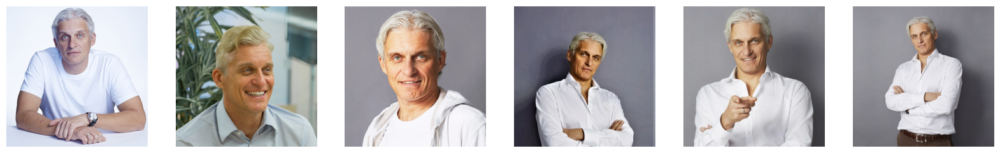

In [21]:
show_instance('/content/drive/MyDrive/dreambooth/train_data/Tinkoff/', 'Tinkoff', res)

In [3]:
promts = ['a photo of OlTinkoff male person with a dog',
          'a photo of OlTinkoff male person in Paris',
          'a photo of OlTinkoff male person on a bicycle',
          'a painting of OlTinkoff male person in van gogh style']

## Learning Rate

Исследуем зависимость качества генерации от количство шагов обучения и learning rate. Возьмём два значения learning rate 1е-4 и 1е-5 (в блоге библиотеки diffusers на страничке LoRA для Dreambooth используется 1е-4, поэтому первым значением я взял его, второе значение поменьше, но не такое маленькое, как в оригинальное статье (5e-6) потому что используется LoRA). Для каждого learning rate сохраняются значения весов на 500, 1000, 1500, 2000 шагах обучения.

In [4]:
lrs = [1e-4, 1e-5]

In [29]:
for lr in lrs:

    train_db(promt='A photo of OlTinkoff male person',
         class_promt='A photo of male person',
         name='Tinkoff',
         exp_name=f'lr_{lr}',
         steps=2000,
         resolution=res,
         lr=lr,
         train_text_encoder=True,
         check_points=True)

2023-08-30 08:27:55.756219: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
The following values were not passed to `accelerate launch` and had defaults used instead:
	`--num_processes` was set to a value of `1`
	`--num_machines` was set to a value of `1`
	`--mixed_precision` was set to a value of `'no'`
	`--dynamo_backend` was set to a value of `'no'`
To avoid this warning pass in values for each of the problematic parameters or run `accelerate config`.
2023-08-30 08:28:03.048568: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
08/30/2023 08:28:06 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'prediction_type', 'clip_sample_range', 'dynami

In [30]:
for lr in lrs:

  for i in range(500, 2500, 500):

      out_dir = f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/lr_{lr}_{i}'

      if not os.path.exists(out_dir):
          !mkdir -p $out_dir

      inference(out_dir=out_dir,
          w_dir=f'/content/output/Tinkoff/lr_{lr}/checkpoint-{i}/pytorch_lora_weights.safetensors',
          promts=promts)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

### * learning rate = 1e-4

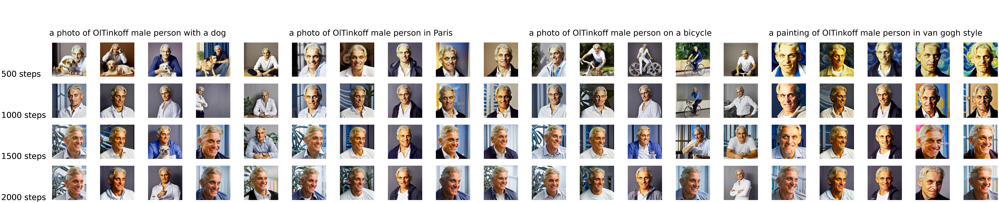

In [49]:
plt.figure(figsize=(100, 20))

for num, promt in enumerate(promts):

    plt.subplot(4 + 1, len(promts) * 5 + 1, 5 * num + 1 + 1)
    plt.text(0, 0, promt, fontsize=45)
    plt.axis('off')

    for i in range(500, 2500, 500):

      files = os.listdir(f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/lr_{lrs[0]}_{i}')

      plt.subplot(4 + 1, len(promts) * 5 + 1, (len(promts) * 5 + 1) * (i // 500) + 1)
      plt.text(0, 0, f'{i} steps', fontsize=45)
      plt.axis('off')

      for x, file in enumerate(files):

        img = Image.open(f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/lr_{lrs[0]}_{i}/{file}')

        img = np.asarray(img)

        pos = (len(promts) * 5 + 1) * (i // 500) + x + 2

        plt.subplot(4 + 1, len(promts) * 5 + 1, pos)
        plt.axis('off')
        plt.imshow(img)


Видно, что модель переобучается уже к 1000 шагу и начинает выдавать изначальные изображения. На пятисотом шаге картинки собакой получились неплохими, но лицо с артефактами, а на последней нет собаки, аналогично с велосипедом. Изображения в стиле Ван Гога на пятисотом шаге хорошо передали лицо (хотя он всё-таки более похоже на фотографию, чем на картину) и фон. Париж не получился совсем, хотя лицо сохранено, никакого характерного фона не появилось.

### * learning rate = 1e-5

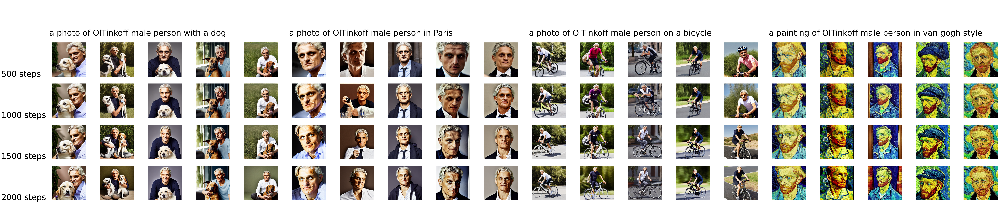

In [50]:
plt.figure(figsize=(100, 20))

for num, promt in enumerate(promts):

    plt.subplot(4 + 1, len(promts) * 5 + 1, 5 * num + 1 + 1)
    plt.text(0, 0, promt, fontsize=45)
    plt.axis('off')

    for i in range(500, 2500, 500):

      files = os.listdir(f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/lr_{lrs[1]}_{i}')

      plt.subplot(4 + 1, len(promts) * 5 + 1, (len(promts) * 5 + 1) * (i // 500) + 1)
      plt.text(0, 0, f'{i} steps', fontsize=45)
      plt.axis('off')

      for x, file in enumerate(files):

        img = Image.open(f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/lr_{lrs[1]}_{i}/{file}')

        img = np.asarray(img)

        pos = (len(promts) * 5 + 1) * (i // 500) + x + 2

        plt.subplot(4 + 1, len(promts) * 5 + 1, pos)
        plt.axis('off')
        plt.imshow(img)


Видно, что с пониженным значением learning rate генерация стала лучше. Изображения получаются разнообразными и не копируют оригинальные (разные позы, освещение, фон). При малом количестве шагов обучения (500, 1000), модель не до конца обучилась и лицо не так сильно похоже на оригинал, хотя черты сохраняются. При 1500 и 2000 шагов получается очень похожее лицо (хотя в стиле Ван Гога всё равно остаётся больше похожим на Ван Гога, с добавлением черт тренировочного лица, зато выглядит как картина, а не как фотография). К сожалению, Париж так и не удалось сгенерировать, видимо влияет выборка тренировочных данных (портретный режим с однотонным фоном). Фотографии на велосипеде получаются с артефактами (возможно тоже выборка влияет, так как лицо на фото на велосипеде гораздо меньше, чем в портретном режиме).

Для следующего эксперимента зафиксируем learning rate равный 1e-5 и количесвто шагов равное 1500.

## Text-Encoder

Проверм, как сильно влияет обучение текстового энкодера на итоговое качество. Для этого обучим две версии моделей, в одной будем дообучать и текстовый энкодер и UNet, во второй - только UNet.

In [34]:
text_encoder = [True, False]

In [32]:
for te in text_encoder:

    train_db(promt='A photo of OlTinkoff male person',
         class_promt='A photo of male person',
         name='Tinkoff',
         exp_name=f'te_{int(te)}',
         steps=1500,
         resolution=res,
         lr=1e-5,
         train_text_encoder=te)

2023-08-30 10:03:20.695510: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
The following values were not passed to `accelerate launch` and had defaults used instead:
	`--num_processes` was set to a value of `1`
	`--num_machines` was set to a value of `1`
	`--mixed_precision` was set to a value of `'no'`
	`--dynamo_backend` was set to a value of `'no'`
To avoid this warning pass in values for each of the problematic parameters or run `accelerate config`.
2023-08-30 10:03:26.997793: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
08/30/2023 10:03:29 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'dynamic_thresholding_ratio', 'sample_max_value

In [33]:
for te in text_encoder:

    out_dir = f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/te_{int(te)}'

    if not os.path.exists(out_dir):
        !mkdir -p $out_dir

    inference(out_dir=out_dir,
        w_dir=f'/content/output/Tinkoff/te_{int(te)}/checkpoint-1500/pytorch_lora_weights.safetensors',
        promts=promts)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

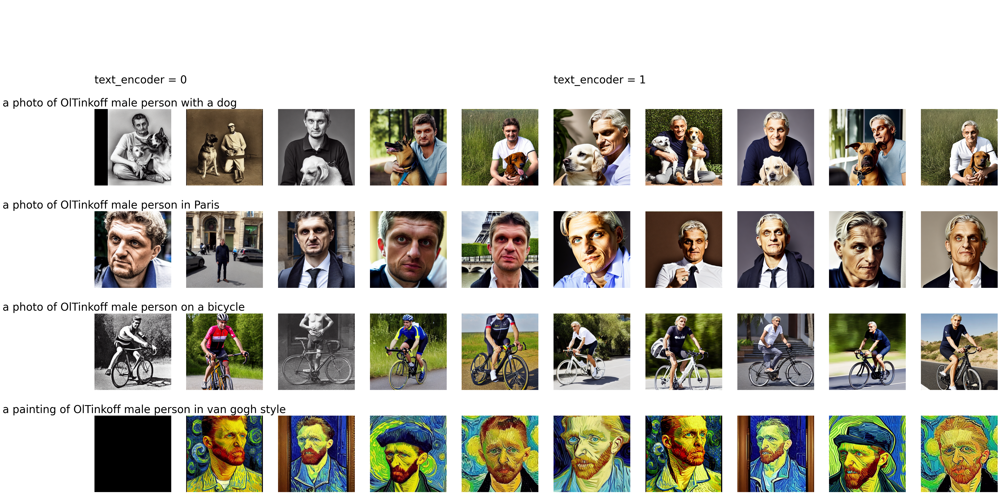

In [51]:
plt.figure(figsize=(50, 25))

for num, promt in enumerate(promts):

    plt.subplot(len(promts) + 1, len(text_encoder) * 5 + 1, 2 + 5 * len(text_encoder) * (num + 1) + num)
    plt.text(0, 0.98, promt, fontsize=30)
    plt.axis('off')

    for i in range(2):

      for j in range(5):

        img = Image.open(f'/content/drive/MyDrive/dreambooth/inference/Tinkoff/te_{i}/{promt}_{j}.png')

        img = np.asarray(img)

        pos = 2 + 5 * len(text_encoder) * (num + 1) + num + j + 1 + 5 * i

        plt.subplot(len(promts) + 1, len(text_encoder) * 5 + 1, pos)
        plt.axis('off')
        plt.imshow(img)


for i in range(2):

    plt.subplot(len(promts) + 1, len(text_encoder) * 5 + 1, i * 5 + 2)
    plt.text(0, 0.05, f'text_encoder = {i}', fontsize=30)
    plt.axis('off')

По получившимся изображениям можно сделать выовд, что текстовый энкодер сильно влияет на результат. Картинки с дообченным текстовым энокдером сохраняют лицо оригинала, но немного уступают в разнообразии (без текстового энкодера получился Париж и различные стили (ч/б фото)). Это может быть связанно с тем, что энкодер начинает уделять больше внимания на токен `OlTinkoff` и забывать про остальные, из-за чего падает разнообразие, но повышается соответсвие оригиналу.

## Хотелось, но не успел...

* Провести эксперименты параметрами на этапе генерации: посмотреть зависимость от количества шагов генерации и поварьировать вклад весов LoRA.

* Получить количественные метрики DINO и CLIP-I

* Сравнить результаты для других объектов (животные, предметы)